# 房产价格市场聚类分析

In [1]:
import json
import networkx as nx
import pandas as pd
from tools.distance_calculator import *

## 数据准备

In [ ]:
with open('data/house_poi_data_more_precise_connected.json', 'r', encoding='utf-8') as f:
    data = json.load(f)

In [ ]:
print(data[0].keys())  # Print the keys of the first house entry to understand the structure

In [ ]:
house_df = pd.read_csv('data/house_property.csv')

# 合并数据
for house_json, house_row in zip(data, house_df.itertuples()):
    house_json['floor'] = house_row.Floor
    house_json['StairsUnitRatio_num'] = house_row.StairsUnitRatio_num
    house_json['BuildingStructure'] = house_row.BuildingStructure

print(f"成功合并 {len(data)} 条房产数据")


In [ ]:
print(data[0])

In [ ]:
for house_json in data:
    tags = []
    for poi in house_json['pois']:
        tags.append(poi['first_tag'])
    if "public_transport" not in tags:
        house_json['has_public_transport'] = 0
    else:
        house_json['has_public_transport'] = 1
    if "healthcare" not in tags:
        house_json['has_healthcare'] = 0
    else:
        house_json['has_healthcare'] = 1
    if "education" not in tags:
        house_json['has_education'] = 0
    else:
        house_json['has_education'] = 1
    if "shop" not in tags:
        house_json['has_shop'] = 0
    else:
        house_json['has_shop'] = 1
    if "amenity" not in tags:
        house_json['has_amenity'] = 0
    else:
        house_json['has_amenity'] = 1
    if "tourism" not in tags:
        house_json['has_tourism'] = 0
    else:
        house_json['has_tourism'] = 1
    if "leisure" not in tags:
        house_json['has_leisure'] = 0
    else:
        house_json['has_leisure'] = 1

### 检测孤立数据点并删除

In [ ]:
# 基本库导入
import networkx as nx
import json
G = nx.Graph()
# 以房屋的id作为代号
with open("data/house_data.json", 'r') as f:
    dataf = json.load(f)
for house in dataf:
    G.add_node(str(house['id']), label = "house")
del dataf
# 以poi自带的id作为代号
with open("data/poi_data.json", 'r') as f:
    dataf = json.load(f)
for poi in dataf:
    G.add_node(poi['id'], label = "poi")
del dataf
with open("data/house_poi_data.json", 'r') as f:
    dataf = json.load(f)
for house in dataf['houses']:
    house_id = str(house['id'])
    if house['pois']:
        for poi in house['pois']:
            G.add_edge(house_id, poi['id'])
del dataf
# 提取出其中的最大连通子图
G_Max_Connected = G.subgraph(max(nx.connected_components(G), key=len))
G_Max_Connected.number_of_nodes()

# 查找所有label为house的节点
house_nodes = [node for node, dataf in G_Max_Connected.nodes(data=True) if dataf.get('label') == 'house']
print(f"找到 {len(house_nodes)} 个房屋节点")
print(f"示例房屋节点: {house_nodes[:5]}")  # 显示前5个

In [ ]:
for house in data:
    if str(house['id']) not in house_nodes:
        while house in data:
            data.remove(house)
print("共保留" + str(len(data)) + "个节点")

In [ ]:
data

In [ ]:
with open("./data/house_poi_data_more_precise_connected.json", "w") as f:
    json.dump(data, f, ensure_ascii=False, indent = 4)

## 使用SKATER算法对房产POI数据进行空间聚类

In [2]:
with open('data/house_poi_data_more_precise_connected.json', 'r', encoding='utf-8') as f:
    houses = json.load(f)

In [3]:
print(len(houses))

9143


In [4]:
# 步骤1: 将房产数据转换为 GeoDataFrame
import geopandas as gpd
from shapely.geometry import Point
from libpysal.weights import KNN
from spopt.region import Skater
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from matplotlib import rcParams
from sklearn.preprocessing import LabelEncoder

# 设置中文字体
rcParams['font.sans-serif'] = ['Arial Unicode MS']  # macOS
rcParams['axes.unicode_minus'] = False

# 创建DataFrame，提取需要的属性
df = pd.DataFrame([{
    'id': house['id'],
    'lon': house['lon'],
    'lat': house['lat'],
    'price_per_meter': house['price_per_meter'],
    'closeness_centrality': house.get('closeness_centrality', 0),
    'has_public_transport': house['has_public_transport'],
    'has_healthcare': house['has_healthcare'],
    'has_education': house['has_education'],
    'has_shop': house['has_shop'],
    'has_amenity': house['has_amenity'],
    'has_tourism': house['has_tourism'],
    'has_leisure': house['has_leisure'],
    'floor': house['floor'],
    'StairsUnitRatio_num': house['StairsUnitRatio_num'],
    'BuildingStructure': house['BuildingStructure'],
} for house in houses])
# 对类别型特征进行数字编码

# 对 floor 进行编码
le_floor = LabelEncoder()
df['floor'] = le_floor.fit_transform(df['floor'])

# 对 BuildingStructure 进行编码
le_building = LabelEncoder()
df['BuildingStructure'] = le_building.fit_transform(df['BuildingStructure'])

print(f"Floor 编码类别: {le_floor.classes_}")
print(f"BuildingStructure 编码类别: {le_building.classes_}")
# 创建Point几何对象
geometry = [Point(house['lon'], house['lat']) for house in houses]

# 创建GeoDataFrame，使用WGS84坐标系(EPSG:4326)
gdf_houses = gpd.GeoDataFrame(df, geometry=geometry, crs='EPSG:4326')

# 转换为投影坐标系(米制)，便于距离计算 - 使用Web Mercator
gdf_houses = gdf_houses.to_crs('EPSG:3857')

print(f"GeoDataFrame创建成功，共{len(gdf_houses)}个房产点")
print(gdf_houses.head())
print(f"\n数据统计:")
print(gdf_houses[['price_per_meter', 'closeness_centrality']].describe())

Floor 编码类别: ['中楼层(共10层)' '中楼层(共11层)' '中楼层(共12层)' '中楼层(共13层)' '中楼层(共14层)' '中楼层(共15层)'
 '中楼层(共16层)' '中楼层(共17层)' '中楼层(共18层)' '中楼层(共19层)' '中楼层(共20层)' '中楼层(共21层)'
 '中楼层(共22层)' '中楼层(共23层)' '中楼层(共24层)' '中楼层(共25层)' '中楼层(共26层)' '中楼层(共27层)'
 '中楼层(共28层)' '中楼层(共30层)' '中楼层(共32层)' '中楼层(共33层)' '中楼层(共4层)' '中楼层(共5层)'
 '中楼层(共6层)' '中楼层(共7层)' '中楼层(共8层)' '中楼层(共9层)' '低楼层(共10层)' '低楼层(共11层)'
 '低楼层(共12层)' '低楼层(共13层)' '低楼层(共14层)' '低楼层(共15层)' '低楼层(共16层)' '低楼层(共17层)'
 '低楼层(共18层)' '低楼层(共19层)' '低楼层(共20层)' '低楼层(共21层)' '低楼层(共22层)' '低楼层(共23层)'
 '低楼层(共24层)' '低楼层(共25层)' '低楼层(共26层)' '低楼层(共27层)' '低楼层(共28层)' '低楼层(共30层)'
 '低楼层(共32层)' '低楼层(共3层)' '低楼层(共5层)' '低楼层(共6层)' '低楼层(共7层)' '低楼层(共8层)'
 '低楼层(共9层)' '地下室' '地下室(共12层)' '地下室(共1层)' '地下室(共20层)' '地下室(共6层)' '地下室(共8层)'
 '地下室(共9层)' '底层(共10层)' '底层(共11层)' '底层(共12层)' '底层(共13层)' '底层(共14层)'
 '底层(共15层)' '底层(共16层)' '底层(共17层)' '底层(共18层)' '底层(共19层)' '底层(共1层)'
 '底层(共20层)' '底层(共21层)' '底层(共22层)' '底层(共23层)' '底层(共24层)' '底层(共25层)'
 '底层(共26层)' '底层(共27层)' '底层(共2层)' '底层(共30层)' '底层(共33层)' '底层(共3层)' '底

In [5]:
# 步骤2: 使用距离带权重矩阵解决孤岛问题
import numpy as np
import matplotlib.pyplot as plt
from libpysal.weights import DistanceBand

from libpysal.weights import KNN, w_union

# 距离带权重
w_dist = DistanceBand.from_dataframe(gdf_houses, threshold=8000, binary=True, silence_warnings=True)

# KNN权重补充
w_knn = KNN.from_dataframe(gdf_houses, k=1000)

# 合并权重
w = w_union(w_dist, w_knn)
w.transform = "b"
w.transform = "b"

In [6]:
# 检测聚类图是否全连通
print(f"连通分量数: {w.n_components}")
if w.n_components > 1:
    print("仍有孤岛，需要进一步调整阈值")

连通分量数: 1


In [7]:
# 步骤3: 数据清洗和标准化
import numpy as np

# 选择用于聚类的属性
attrs = ['price_per_meter', 
         'closeness_centrality',
         'has_public_transport',
         'has_healthcare',
         'has_education',
         'has_shop',
         'has_amenity',
         'has_tourism',
         'has_leisure',
         'floor',
         'StairsUnitRatio_num',
         'BuildingStructure',
            ]

# 检查缺失值
print("检查缺失值:")
print(gdf_houses[attrs].isnull().sum())

# 填充缺失值（用中位数填充数值型，用0填充布尔型）
for attr in attrs:
    if gdf_houses[attr].isnull().any():
        if attr.startswith('has_'):
            gdf_houses[attr] = gdf_houses[attr].fillna(0)
        else:
            gdf_houses[attr] = gdf_houses[attr].fillna(gdf_houses[attr].median())
        print(f"已填充 {attr} 的缺失值")

# 标准化
scaler = StandardScaler()
gdf_houses[attrs] = scaler.fit_transform(gdf_houses[attrs])

print(f"\n✓ 属性标准化完成")
print(f"使用的聚类属性: {attrs}")
print(f"\n标准化后数据统计:")
print(gdf_houses[attrs].describe())

检查缺失值:
price_per_meter         0
closeness_centrality    0
has_public_transport    0
has_healthcare          0
has_education           0
has_shop                0
has_amenity             0
has_tourism             0
has_leisure             0
floor                   0
StairsUnitRatio_num     8
BuildingStructure       0
dtype: int64
已填充 StairsUnitRatio_num 的缺失值

✓ 属性标准化完成
使用的聚类属性: ['price_per_meter', 'closeness_centrality', 'has_public_transport', 'has_healthcare', 'has_education', 'has_shop', 'has_amenity', 'has_tourism', 'has_leisure', 'floor', 'StairsUnitRatio_num', 'BuildingStructure']

标准化后数据统计:
       price_per_meter  closeness_centrality  has_public_transport  \
count     9.143000e+03          9.143000e+03          9.143000e+03   
mean     -4.973721e-17          1.709717e-17         -8.369841e-16   
std       1.000055e+00          1.000055e+00          1.000055e+00   
min      -2.533229e+00         -3.317231e+00         -2.650109e+01   
25%      -7.029870e-01         -7.710607e-01 

In [8]:
# 步骤4a: 使用肘部法则确定最优聚类数量
import time
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

# 定义聚类数量范围
cluster_range = range(2, 16)  # 测试3到15个聚类
inertias = []  # 存储每个聚类数的异质性（类内方差）
silhouette_scores = []  # 存储轮廓系数
execution_times = []  # 存储每次训练时间

print("=" * 60)
print("开始肘部法则分析...")
print(f"数据点数量: {len(gdf_houses)}")
print(f"聚类特征数量: {len(attrs)}")
print(f"测试聚类数范围: {min(cluster_range)} - {max(cluster_range)}")
print("=" * 60)

# 使用进度条显示训练进度
for n_clusters in tqdm(cluster_range, desc="训练进度"):
    print(f"\n{'='*50}")
    print(f"正在测试 {n_clusters} 个聚类...")
    
    iter_start = time.time()
    
    try:
        # 创建并训练模型
        model_temp = Skater(
            gdf=gdf_houses,
            w=w,
            attrs_name=attrs,
            n_clusters=n_clusters,
            trace=False
        )
        
        model_temp.solve()
        
        # 记录执行时间
        iter_time = time.time() - iter_start
        execution_times.append(iter_time)
        
        # 获取聚类标签
        labels = model_temp.labels_
        
        # 计算异质性（类内平方和）
        # 对于SKATER，我们计算每个聚类的属性方差总和
        cluster_variance = 0
        for cluster_id in range(n_clusters):
            cluster_mask = labels == cluster_id
            if cluster_mask.sum() > 0:
                cluster_data = gdf_houses.loc[cluster_mask, attrs]
                cluster_variance += cluster_data.var().sum()
        
        inertias.append(cluster_variance)
        
        # 计算轮廓系数（如果数据量不太大）
        if len(gdf_houses) < 10000:
            from sklearn.metrics import silhouette_score
            # 使用标准化后的属性数据计算轮廓系数
            X = gdf_houses[attrs].values
            sil_score = silhouette_score(X, labels, metric='euclidean')
            silhouette_scores.append(sil_score)
        else:
            silhouette_scores.append(None)
        
        # 实时显示结果
        print(f"✓ 完成！")
        print(f"  - 耗时: {iter_time:.2f} 秒")
        print(f"  - 类内方差: {cluster_variance:.4f}")
        if silhouette_scores[-1] is not None:
            print(f"  - 轮廓系数: {silhouette_scores[-1]:.4f}")
        print(f"  - 各聚类样本数: {np.bincount(labels)}")
        
    except Exception as e:
        print(f"✗ 失败: {str(e)}")
        inertias.append(None)
        silhouette_scores.append(None)
        execution_times.append(None)

print("\n" + "=" * 60)
print("肘部法则分析完成！")
print(f"总耗时: {sum([t for t in execution_times if t is not None]):.2f} 秒")
print("=" * 60)
    
# 保存分析结果
analysis_results = {
    'cluster_range': list(cluster_range),
    'inertias': inertias,
    'silhouette_scores': silhouette_scores,
    'execution_times': execution_times
}

import json
with open('data/elbow_analysis_results_v3.json', 'w', encoding='utf-8') as f:
    json.dump(analysis_results, f, ensure_ascii=False, indent=2)

print("\n分析结果已保存到 data/elbow_analysis_results_v3.json")

开始肘部法则分析...
数据点数量: 9143
聚类特征数量: 12
测试聚类数范围: 2 - 15


训练进度:   0%|          | 0/14 [00:00<?, ?it/s]


正在测试 2 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:   7%|▋         | 1/14 [00:11<02:29, 11.53s/it]

✓ 完成！
  - 耗时: 11.03 秒
  - 类内方差: 13.0370
  - 轮廓系数: 0.2357
  - 各聚类样本数: [7824 1319]

正在测试 3 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:  14%|█▍        | 2/14 [00:30<03:08, 15.72s/it]

✓ 完成！
  - 耗时: 18.14 秒
  - 类内方差: 17.7994
  - 轮廓系数: 0.2224
  - 各聚类样本数: [7380 1319  444]

正在测试 4 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:  21%|██▏       | 3/14 [00:57<03:48, 20.82s/it]

✓ 完成！
  - 耗时: 26.45 秒
  - 类内方差: 25.4239
  - 轮廓系数: 0.1856
  - 各聚类样本数: [3620 1319 3760  444]

正在测试 5 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:  29%|██▊       | 4/14 [01:33<04:29, 26.99s/it]

✓ 完成！
  - 耗时: 36.04 秒
  - 类内方差: 31.5311
  - 轮廓系数: 0.1916
  - 各聚类样本数: [3085 1319 3760  444  535]

正在测试 6 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:  36%|███▌      | 5/14 [02:19<05:05, 33.98s/it]

✓ 完成！
  - 耗时: 45.92 秒
  - 类内方差: 88.5165
  - 轮廓系数: 0.1986
  - 各聚类样本数: [2782 1319 3760  444  535  303]

正在测试 7 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:  43%|████▎     | 6/14 [03:16<05:34, 41.80s/it]

✓ 完成！
  - 耗时: 56.57 秒
  - 类内方差: 93.6825
  - 轮廓系数: 0.2149
  - 各聚类样本数: [2782 1319 3341  444  419  535  303]

正在测试 8 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:  50%|█████     | 7/14 [04:26<05:55, 50.79s/it]

✓ 完成！
  - 耗时: 68.91 秒
  - 类内方差: 95.6273
  - 轮廓系数: 0.1914
  - 各聚类样本数: [2782 1319 2457  444  419  884  535  303]

正在测试 9 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:  57%|█████▋    | 8/14 [05:48<06:05, 60.94s/it]

✓ 完成！
  - 耗时: 82.31 秒
  - 类内方差: 98.0285
  - 轮廓系数: 0.1534
  - 各聚类样本数: [1615 1319 2457  444  419  884  535 1167  303]

正在测试 10 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:  64%|██████▍   | 9/14 [07:21<05:54, 70.89s/it]

✓ 完成！
  - 耗时: 92.39 秒
  - 类内方差: 99.8839
  - 轮廓系数: 0.1428
  - 各聚类样本数: [1615  666  653 2457  444  419  884  535 1167  303]

正在测试 11 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:  71%|███████▏  | 10/14 [09:09<05:29, 82.31s/it]

✓ 完成！
  - 耗时: 107.51 秒
  - 类内方差: 101.0131
  - 轮廓系数: 0.1405
  - 各聚类样本数: [ 758  666  857  653 2457  444  419  884  535 1167  303]

正在测试 12 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:  79%|███████▊  | 11/14 [11:12<04:44, 94.89s/it]

✓ 完成！
  - 耗时: 123.05 秒
  - 类内方差: 100.9551
  - 轮廓系数: 0.1441
  - 各聚类样本数: [ 758  666  857  653 2457  444  201  884  535 1167  218  303]

正在测试 13 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:  86%|████████▌ | 12/14 [13:30<03:35, 107.79s/it]

✓ 完成！
  - 耗时: 136.94 秒
  - 类内方差: 102.1800
  - 轮廓系数: 0.1390
  - 各聚类样本数: [ 758  666  857  653 2457  444  201  884  245 1167  218  290  303]

正在测试 14 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度:  93%|█████████▎| 13/14 [16:02<02:01, 121.24s/it]

✓ 完成！
  - 耗时: 151.79 秒
  - 类内方差: 748.0560
  - 轮廓系数: 0.1472
  - 各聚类样本数: [ 758  666  857  653 2457  444  201  884  245 1167  218  290  290   13]

正在测试 15 个聚类...


/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: divide by zero encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: overflow encountered in matmul
  ret = a @ b
/opt/anaconda3/envs/network_analysis/lib/python3.13/site-packages/sklearn/utils/extmath.py:203: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b
训练进度: 100%|██████████| 14/14 [18:42<00:00, 80.19s/it] 

✓ 完成！
  - 耗时: 159.86 秒
  - 类内方差: 750.7385
  - 轮廓系数: 0.1580
  - 各聚类样本数: [ 758  666  857  653 2338  444  201  884  245 1167  218  290  290   13
  119]

肘部法则分析完成！
总耗时: 1116.90 秒

分析结果已保存到 data/elbow_analysis_results_v3.json


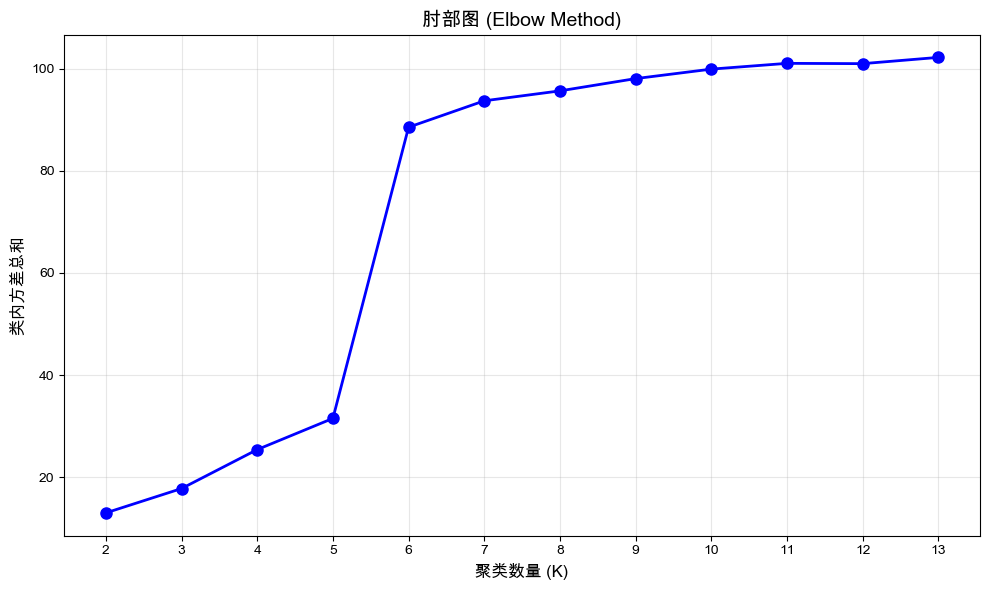

In [25]:
# 可视化结果
fig, axes = plt.subplots(1, 1, figsize=(10, 6))
axes = [axes]  # Convert single axis to list for consistent indexing

# 1. 类内方差图（肘部图）
valid_inertias = [(k, v) for k, v in zip(cluster_range, inertias) if v is not None if k <= 13]
if valid_inertias:
    k_values, inertia_values = zip(*valid_inertias)
    axes[0].plot(k_values, inertia_values, 'bo-', linewidth=2, markersize=8)
    axes[0].set_xlabel('聚类数量 (K)', fontsize=12)
    axes[0].set_ylabel('类内方差总和', fontsize=12)
    axes[0].set_title('肘部图 (Elbow Method)', fontsize=14, fontweight='bold')
    axes[0].grid(True, alpha=0.3)
    axes[0].set_xticks(k_values)

plt.tight_layout()
plt.savefig("image/ElbowImage.png", dpi=600)
plt.show()

In [ ]:
# 步骤4b: 运行SKATER聚类算法（使用最优聚类数）
import time
from datetime import datetime

# 根据肘部法则分析结果设置聚类数量
# 如果已经运行了肘部法则分析，可以使用推荐的聚类数
n_clusters = 6  # 根据肘部法则结果选择的聚类数
# 距离带权重
w_dist = DistanceBand.from_dataframe(gdf_houses, threshold=8000, binary=True, silence_warnings=True)
k_neighbors = 1000
# KNN权重补充
w_knn = KNN.from_dataframe(gdf_houses, k=1000)

# 合并权重
w = w_union(w_dist, w_knn)
w.transform = "b"
w.transform = "b"
print("=" * 70)
print("🚀 开始SKATER空间聚类训练")
print("=" * 70)
print(f"开始时间: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
print(f"数据点数量: {len(gdf_houses):,}")
print(f"聚类特征数量: {len(attrs)}")
print(f"目标聚类数: {n_clusters}")
print(f"空间权重邻居数: {k_neighbors}")
print("-" * 70)

# 详细的时间追踪
total_start = time.time()

# 1. 模型初始化
print("\n[1/3] 初始化SKATER模型...")
init_start = time.time()
model = Skater(
    gdf=gdf_houses,
    w=w,
    attrs_name=attrs,
    n_clusters=n_clusters,
    trace=False
)
init_time = time.time() - init_start
print(f"      ✓ 初始化完成，耗时: {init_time:.2f} 秒")

# 2. 执行聚类
print("\n[2/3] 执行聚类算法...")
solve_start = time.time()
model.solve()
solve_time = time.time() - solve_start
print(f"      ✓ 聚类完成，耗时: {solve_time:.2f} 秒")

# 3. 后处理
print("\n[3/3] 处理聚类结果...")
post_start = time.time()
gdf_houses['cluster'] = model.labels_
cluster_counts = gdf_houses['cluster'].value_counts().sort_index()
post_time = time.time() - post_start
print(f"      ✓ 后处理完成，耗时: {post_time:.2f} 秒")

# 总计时间
total_time = time.time() - total_start

# 输出结果摘要
print("\n" + "=" * 70)
print("✨ SKATER聚类训练完成！")
print("=" * 70)
print(f"完成时间: {datetime.now().strftime('%Y-%m-%d %H:%M:%S')}")
print(f"\n⏱️  时间统计:")
print(f"  - 模型初始化: {init_time:.2f} 秒 ({init_time/total_time*100:.1f}%)")
print(f"  - 聚类计算:   {solve_time:.2f} 秒 ({solve_time/total_time*100:.1f}%)")
print(f"  - 结果处理:   {post_time:.2f} 秒 ({post_time/total_time*100:.1f}%)")
print(f"  - 总耗时:     {total_time:.2f} 秒")
print(f"\n📊 聚类结果:")
print(f"  - 目标聚类数: {n_clusters}")
print(f"  - 实际生成聚类数: {len(set(model.labels_))}")
print(f"  - 平均处理速度: {len(gdf_houses)/total_time:.1f} 个样本/秒")
print(f"\n📈 各聚类样本分布:")
for cluster_id, count in cluster_counts.items():
    percentage = count / len(gdf_houses) * 100
    bar = "█" * int(percentage / 2)
    print(f"  聚类 {cluster_id}: {count:>5} 样本 ({percentage:>5.1f}%) {bar}")

print("=" * 70)

# 保存训练日志
training_log = {
    'timestamp': datetime.now().isoformat(),
    'n_clusters': n_clusters,
    'data_points': len(gdf_houses),
    'features': len(attrs),
    'times': {
        'initialization': init_time,
        'solving': solve_time,
        'post_processing': post_time,
        'total': total_time
    },
    'cluster_distribution': cluster_counts.to_dict()
}

with open('data/skater_training_log.json', 'w', encoding='utf-8') as f:
    json.dump(training_log, f, ensure_ascii=False, indent=2)

print("\n训练日志已保存到 data/skater_training_log.json")

🚀 开始SKATER空间聚类训练
开始时间: 2025-10-28 23:16:46
数据点数量: 9,143
聚类特征数量: 12
目标聚类数: 6
空间权重邻居数: 1000
----------------------------------------------------------------------

[1/3] 初始化SKATER模型...
      ✓ 初始化完成，耗时: 0.00 秒

[2/3] 执行聚类算法...
      ✓ 聚类完成，耗时: 47.35 秒

[3/3] 处理聚类结果...
      ✓ 后处理完成，耗时: 0.00 秒

✨ SKATER聚类训练完成！
完成时间: 2025-10-28 23:17:34

⏱️  时间统计:
  - 模型初始化: 0.00 秒 (0.0%)
  - 聚类计算:   47.35 秒 (100.0%)
  - 结果处理:   0.00 秒 (0.0%)
  - 总耗时:     47.35 秒

📊 聚类结果:
  - 目标聚类数: 6
  - 实际生成聚类数: 6
  - 平均处理速度: 193.1 个样本/秒

📈 各聚类样本分布:
  聚类 0:  2782 样本 ( 30.4%) ███████████████
  聚类 1:  1319 样本 ( 14.4%) ███████
  聚类 2:  3760 样本 ( 41.1%) ████████████████████
  聚类 3:   444 样本 (  4.9%) ██
  聚类 4:   535 样本 (  5.9%) ██
  聚类 5:   303 样本 (  3.3%) █

训练日志已保存到 data/skater_training_log.json


In [35]:
# 保存gdf_houses到文件
# 保存为GeoJSON格式（保留地理信息）
gdf_houses.to_file('data/gdf_houses_clustered.geojson', driver='GeoJSON')

# 保存为Shapefile格式
# gdf_houses.to_file('data/gdf_houses_clustered.shp')

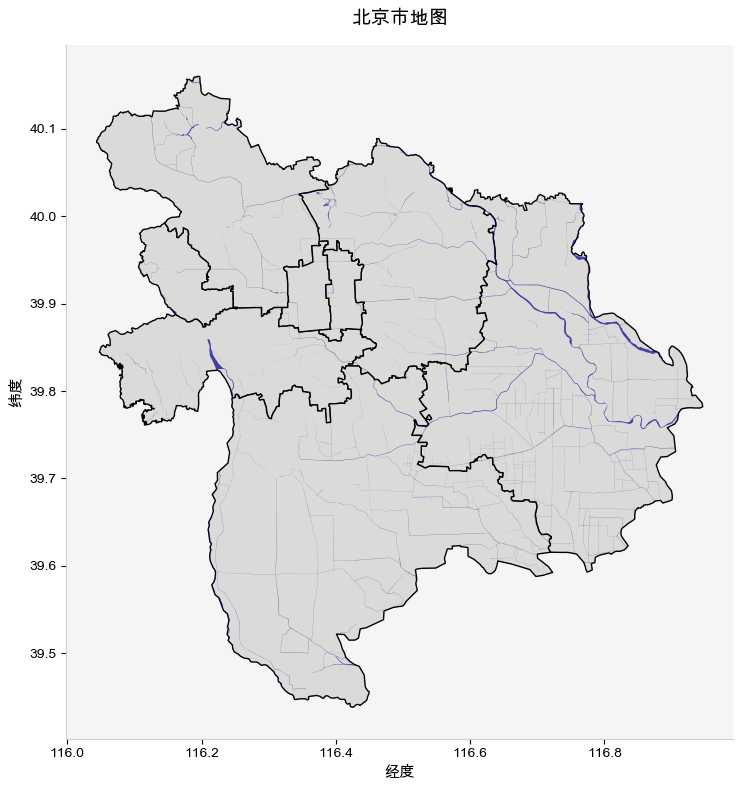

In [42]:
import geopandas as gpd
import matplotlib.pyplot as plt

# 读取包含中国省市的矢量地图
beijing = gpd.read_file('data/beijing/北京区县界.shp')
beijing_river = gpd.read_file('data/beijing/北京河流.shp')

beijing_center_district = [
    "海淀区",
    "朝阳区",
    "石景山区",
    "西城区",
    "东城区",
    "丰台区",
    "大兴区",
    "通州区"
]
# 过滤出中心区县
beijing = beijing[beijing['NAME'].isin(beijing_center_district)]

# 用中心区县的边界裁剪河流（空间裁剪，不依赖河流的NAME字段）
beijing_boundary = beijing.union_all()  # 合并所有中心区县为一个多边形
beijing_river = gpd.clip(beijing_river, beijing_boundary)

# 绘制地图 - 高级配色方案
fig, ax = plt.subplots(figsize=(10, 8), facecolor='white')
ax.set_facecolor('#F5F5F5')  # 浅灰色背景

beijing.plot(ax=ax, facecolor='#dbdad9', edgecolor='black', linewidth=1)

beijing_river.plot(ax=ax, color='darkblue', linewidth=1.2, alpha=0.7)

plt.title('北京市地图', fontsize=14, fontweight='bold', pad=15)
plt.xlabel('经度', fontsize=11)
plt.ylabel('纬度', fontsize=11)

# 去除顶部和右侧边框，更简洁
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_color('#CCCCCC')
ax.spines['bottom'].set_color('#CCCCCC')

plt.tight_layout()
plt.show()


/var/folders/0m/2sbyxxc10czg8dp3clzyzxym0000gn/T/ipykernel_87368/2239061053.py:42: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab10', n_clusters)



✓ 聚类结果可视化完成!
可视化耗时: 0.23 秒

图例说明:
- 彩色点:房产POI位置(按聚类着色)
- 灰色区域:北京区县边界
- 蓝色线条:河流水系
- 右侧图例:显示6个聚类的颜色、数量、占比及平均房价

各聚类平均房价统计:
  聚类 0: ¥29,101/㎡
  聚类 1: ¥35,737/㎡
  聚类 2: ¥27,356/㎡
  聚类 3: ¥14,453/㎡
  聚类 4: ¥18,455/㎡
  聚类 5: ¥15,316/㎡


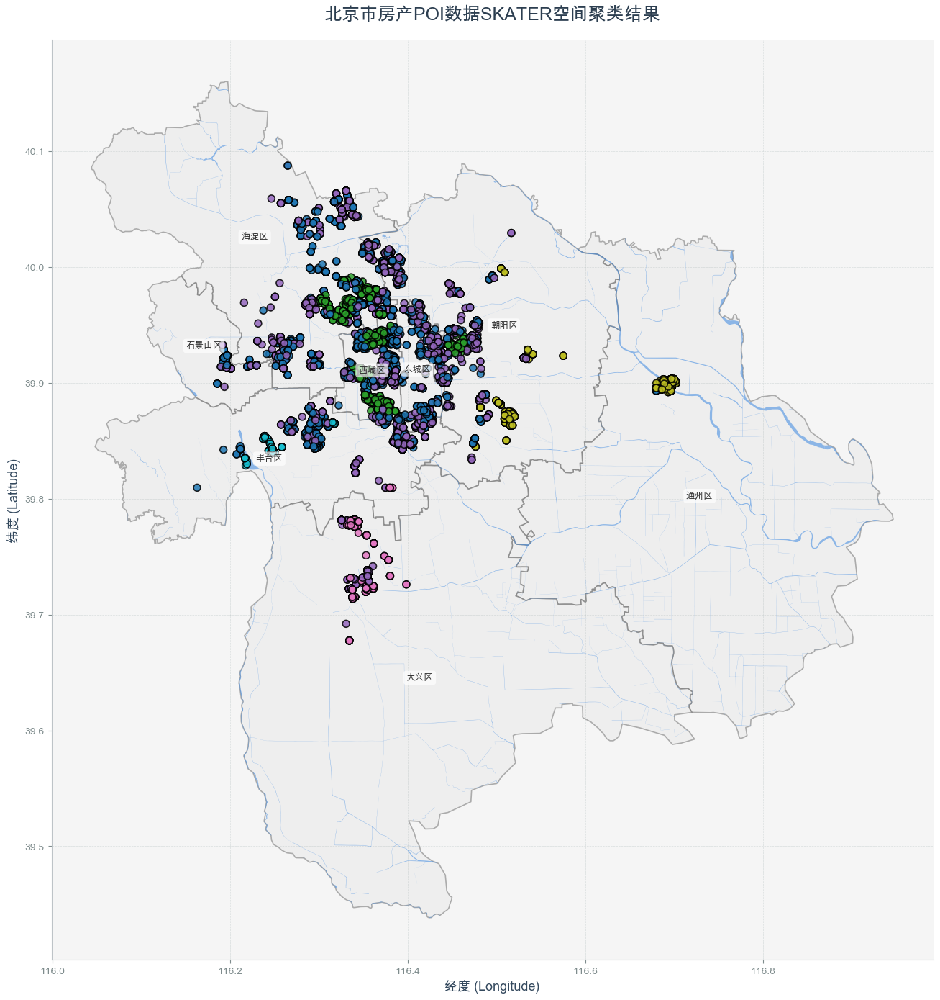

In [66]:
# 步骤5: 可视化聚类结果(结合北京地图)
import time
import matplotlib.patches as mpatches

viz_start = time.time()

# 创建图形
fig, ax = plt.subplots(1, 1, figsize=(16, 14), facecolor='white')
ax.set_facecolor('#F5F5F5')

# 1. 首先绘制北京区县边界(底图)
beijing.plot(
    ax=ax, 
    facecolor='#E8E8E8',  # 浅灰色填充
    edgecolor='#666666',   # 深灰色边界
    linewidth=1.2,
    alpha=0.5,
    zorder=1
)

# 2. 绘制河流
beijing_river.plot(
    ax=ax, 
    color='#4A90E2',  # 蓝色
    linewidth=1.5, 
    alpha=0.6,
    zorder=2
)

# 3. 转换聚类结果回WGS84坐标系以便显示
gdf_houses_wgs84 = gdf_houses.to_crs('EPSG:4326')

# 4. 计算各聚类的平均房价(需要从原始数据获取)
cluster_avg_prices = {}
for cluster_id in range(n_clusters):
    cluster_indices = gdf_houses[gdf_houses['cluster'] == cluster_id].index
    cluster_prices = df.loc[cluster_indices, 'price_per_meter'].astype(float)
    cluster_avg_prices[cluster_id] = cluster_prices.mean()

# 5. 获取用于绘制的colormap - 使用更鲜明的tab10配色
from matplotlib import cm
cmap = cm.get_cmap('tab10', n_clusters)

# 6. 绘制聚类结果(在最上层) - 增强视觉效果
scatter = gdf_houses_wgs84.plot(
    column='cluster',
    cmap='tab10',  # 使用更鲜明的颜色方案
    markersize=50,  # 增大点的大小(从30增加到50)
    alpha=0.85,  # 提高不透明度(从0.7增加到0.85)
    edgecolor='black',  # 使用黑色边缘,对比更强烈
    linewidth=1.2,  # 增加边缘宽度(从0.8增加到1.2)
    ax=ax,
    legend=False,  # 先不显示默认图例
    zorder=3,
)

# 7. 创建自定义图例
legend_elements = []
for cluster_id in range(n_clusters):
    cluster_count = cluster_counts[cluster_id]
    cluster_percentage = cluster_count / len(gdf_houses) * 100
    avg_price = cluster_avg_prices[cluster_id]
    color = cmap(cluster_id)
    
    legend_elements.append(
        mpatches.Patch(
            facecolor=color, 
            edgecolor='black',  # 图例边缘也改为黑色
            linewidth=1.5,  # 增加图例边缘宽度
            label=f'聚类 {cluster_id}: {cluster_count} 个 ({cluster_percentage:.1f}%)\n平均房价: ¥{avg_price:,.0f}/㎡'
        )
    )

# 8. 添加区县名称标注(可选)
for idx, row in beijing.iterrows():
    centroid = row.geometry.centroid
    ax.annotate(
        text=row['NAME'],
        xy=(centroid.x, centroid.y),
        fontsize=9,
        ha='center',
        va='center',
        color='#333333',
        weight='bold',
        bbox=dict(boxstyle='round,pad=0.3', facecolor='white', edgecolor='none', alpha=0.7),
        zorder=4
    )

# 9. 设置标题和标签
ax.set_title('北京市房产POI数据SKATER空间聚类结果', 
             fontsize=18, 
             fontweight='bold', 
             pad=20,
             color='#2C3E50')
ax.set_xlabel('经度 (Longitude)', fontsize=13, color='#34495E')
ax.set_ylabel('纬度 (Latitude)', fontsize=13, color='#34495E')

# 10. 美化坐标轴
ax.tick_params(axis='both', which='major', labelsize=10, colors='#7F8C8D')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_color('#BDC3C7')
ax.spines['bottom'].set_color('#BDC3C7')

# 11. 添加网格
ax.grid(True, linestyle='--', alpha=0.3, color='#95A5A6', linewidth=0.5)

plt.tight_layout()
viz_time = time.time() - viz_start

print(f"\n✓ 聚类结果可视化完成!")
print(f"可视化耗时: {viz_time:.2f} 秒")
print(f"\n图例说明:")
print(f"- 彩色点:房产POI位置(按聚类着色)")
print(f"- 灰色区域:北京区县边界")
print(f"- 蓝色线条:河流水系")
print(f"- 右侧图例:显示6个聚类的颜色、数量、占比及平均房价")
print(f"\n各聚类平均房价统计:")
for cluster_id in range(n_clusters):
    print(f"  聚类 {cluster_id}: ¥{cluster_avg_prices[cluster_id]:,.0f}/㎡")
plt.savefig("image/SKATER_BEIJING.png", dpi=600)
plt.show()

In [23]:
# 步骤6: 统计各聚类的主要影响因素
import pandas as pd
import numpy as np

# 获取原始特征数据（标准化前）
feature_columns = [
    'price_per_meter', 'closeness_centrality', 'has_public_transport',
    'has_healthcare', 'has_education', 'has_shop', 'has_amenity',
    'has_tourism', 'has_leisure', 'floor', 'StairsUnitRatio_num',
    'BuildingStructure'
]

# 计算每个聚类的特征均值
cluster_stats = []
for cluster_id in range(n_clusters):
    cluster_indices = gdf_houses[gdf_houses['cluster'] == cluster_id].index
    cluster_data = df.loc[cluster_indices, feature_columns].copy()
    
    # 转换数值类型
    for col in feature_columns:
        if col in ['price_per_meter', 'closeness_centrality', 'StairsUnitRatio_num']:
            cluster_data[col] = pd.to_numeric(cluster_data[col], errors='coerce')
    
    # 计算均值
    cluster_mean = cluster_data.mean()
    cluster_mean['cluster_id'] = cluster_id
    cluster_mean['count'] = len(cluster_indices)
    cluster_stats.append(cluster_mean)

# 创建统计DataFrame
stats_df = pd.DataFrame(cluster_stats)

# 计算全局均值用于比较
global_mean = df[feature_columns].copy()
for col in feature_columns:
    if col in ['price_per_meter', 'closeness_centrality', 'StairsUnitRatio_num']:
        global_mean[col] = pd.to_numeric(global_mean[col], errors='coerce')
global_mean = global_mean.mean()

# 计算偏离度（相对于全局均值）
deviation_df = stats_df[feature_columns].copy()
for col in feature_columns:
    if col in global_mean.index:
        deviation_df[col] = (stats_df[col] - global_mean[col]) / (global_mean[col] + 1e-10)

# 为每个聚类找出最显著的特征（前3个）
print("\n" + "="*80)
print("各聚类主要影响因素分析")
print("="*80)

cluster_characteristics = {}
for cluster_id in range(n_clusters):
    print(f"\n【聚类 {cluster_id}】({int(stats_df.loc[cluster_id, 'count'])} 个样本)")
    print("-" * 60)
    
    # 获取该聚类的偏离度
    deviations = deviation_df.iloc[cluster_id].abs().sort_values(ascending=False)
    top_features = deviations.head(5)
    
    characteristics = []
    for feature, dev in top_features.items():
        actual_value = stats_df.loc[cluster_id, feature]
        global_value = global_mean[feature]
        
        # 格式化输出
        if feature == 'price_per_meter':
            print(f"  • 平均房价: ¥{actual_value:,.0f}/㎡ (全局均值: ¥{global_value:,.0f}/㎡, {dev*100:+.1f}%)")
            characteristics.append(f"房价{'高' if actual_value > global_value else '低'}")
        elif feature == 'closeness_centrality':
            print(f"  • 中心性: {actual_value:.4f} (全局均值: {global_value:.4f}, {dev*100:+.1f}%)")
            characteristics.append(f"{'核心' if actual_value > global_value else '边缘'}区域")
        elif feature.startswith('has_'):
            feature_name = {
                'has_public_transport': '公共交通',
                'has_healthcare': '医疗设施',
                'has_education': '教育设施',
                'has_shop': '商业设施',
                'has_amenity': '便利设施',
                'has_tourism': '旅游景点',
                'has_leisure': '休闲设施'
            }.get(feature, feature)
            print(f"  • {feature_name}: {actual_value*100:.1f}% (全局均值: {global_value*100:.1f}%, {dev*100:+.1f}%)")
            if abs(dev) > 0.1:
                characteristics.append(f"{feature_name}{'丰富' if actual_value > global_value else '稀缺'}")
        elif feature == 'floor':
            print(f"  • 楼层: {actual_value:.1f} (全局均值: {global_value:.1f}, {dev*100:+.1f}%)")
            if abs(dev) > 0.2:
                characteristics.append(f"{'高' if actual_value > global_value else '低'}楼层")
        elif feature == 'StairsUnitRatio_num':
            print(f"  • 梯户比: {actual_value:.2f} (全局均值: {global_value:.2f}, {dev*100:+.1f}%)")
            if abs(dev) > 0.2:
                characteristics.append(f"梯户比{'高' if actual_value > global_value else '低'}")
        elif feature == 'BuildingStructure':
            print(f"  • 建筑结构: {actual_value:.2f} (全局均值: {global_value:.2f}, {dev*100:+.1f}%)")
    
    cluster_characteristics[cluster_id] = characteristics[:3]
    
    print(f"\n  ✓ 主要特征: {', '.join(characteristics[:3])}")

# 创建可视化总结
print("\n" + "="*80)
print("聚类特征总结")
print("="*80)
for cluster_id in range(n_clusters):
    count = int(stats_df.loc[cluster_id, 'count'])
    percentage = count / len(gdf_houses) * 100
    avg_price = stats_df.loc[cluster_id, 'price_per_meter']
    chars = ', '.join(cluster_characteristics[cluster_id])
    print(f"聚类 {cluster_id}: {count:4d} 个 ({percentage:5.1f}%) | ¥{avg_price:6,.0f}/㎡ | {chars}")

print("\n✓ 聚类影响因素统计完成！")



各聚类主要影响因素分析

【聚类 0】(2782 个样本)
------------------------------------------------------------
  • 医疗设施: 0.0% (全局均值: 14.6%, +99.8%)
  • 建筑结构: 1.03 (全局均值: 2.53, +59.5%)
  • 旅游景点: 99.7% (全局均值: 84.2%, +18.4%)
  • 楼层: 73.6 (全局均值: 65.1, +13.1%)
  • 商业设施: 99.1% (全局均值: 88.8%, +11.6%)

  ✓ 主要特征: 医疗设施稀缺, 旅游景点丰富, 商业设施丰富

【聚类 1】(1319 个样本)
------------------------------------------------------------
  • 医疗设施: 100.0% (全局均值: 14.6%, +586.9%)
  • 平均房价: ¥35,737/㎡ (全局均值: ¥27,550/㎡, +29.7%)
  • 旅游景点: 100.0% (全局均值: 84.2%, +18.8%)
  • 中心性: 0.1949 (全局均值: 0.1665, +17.1%)
  • 梯户比: 0.31 (全局均值: 0.37, +14.9%)

  ✓ 主要特征: 医疗设施丰富, 房价高, 旅游景点丰富

【聚类 2】(3760 个样本)
------------------------------------------------------------
  • 医疗设施: 0.3% (全局均值: 14.6%, +98.0%)
  • 建筑结构: 3.71 (全局均值: 2.53, +46.4%)
  • 商业设施: 99.8% (全局均值: 88.8%, +12.4%)
  • 楼层: 59.9 (全局均值: 65.1, +8.0%)
  • 旅游景点: 87.2% (全局均值: 84.2%, +3.6%)

  ✓ 主要特征: 医疗设施稀缺, 商业设施丰富

【聚类 3】(444 个样本)
------------------------------------------------------------
  • 医疗设施: 0.0% (全局

# 总绘图

In [58]:
# 完整的带聚类边界的可视化代码

import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from shapely.geometry import MultiPoint
from matplotlib import cm

# 创建图形 - 设置透明背景
fig, ax = plt.subplots(1, 1, figsize=(16, 14), dpi=600, facecolor='none')
ax.set_facecolor('none')  # 坐标轴背景也设为透明

# 1. 绘制北京底图
beijing.plot(ax=ax, facecolor='white', edgecolor='#9e9e9e', 
             linewidth=1.2, alpha=0.5, zorder=0)
beijing_river.plot(ax=ax, color='#4A90E2', linewidth=1.5, 
                   alpha=0.6, zorder=2)

# 2. 转换坐标系
gdf_houses_wgs84 = gdf_houses.to_crs('EPSG:4326')
cmap = cm.get_cmap('tab10', n_clusters)

# 3. 绘制每个聚类的边界和填充区域
for cluster_id in range(n_clusters):
    cluster_points = gdf_houses_wgs84[gdf_houses_wgs84['cluster'] == cluster_id]
    
    # 创建凸包
    points = MultiPoint(list(cluster_points.geometry))
    convex_hull = points.convex_hull
    
    color = cmap(cluster_id)
    
    if convex_hull.geom_type == 'Polygon':
        x, y = convex_hull.exterior.xy
        # 填充半透明区域
        ax.fill(x, y, color=color, alpha=0.15, zorder=2, label=f'聚类 {cluster_id} 区域')
        # 绘制边界线
        ax.plot(x, y, color=color, linewidth=3, alpha=0.9, zorder=2.5, linestyle='-')

# 4. 绘制聚类点
gdf_houses_wgs84.plot(
    column='cluster',
    cmap='tab10',
    markersize=40,
    alpha=0.85,
    edgecolor='white',
    linewidth=1.0,
    ax=ax,
    legend=False,
    zorder=3
)

# 5. 添加标题和图例
ax.set_title('北京市房产聚类分析 - 带区域边界', 
             fontsize=18, fontweight='bold', pad=20)
ax.set_xlabel('经度', fontsize=13)
ax.set_ylabel('纬度', fontsize=13)
ax.grid(True, linestyle='--', alpha=0.3)

# 7. 创建自定义图例
legend_elements = []
for cluster_id in range(n_clusters):
    cluster_count = cluster_counts[cluster_id]
    cluster_percentage = cluster_count / len(gdf_houses) * 100
    avg_price = cluster_avg_prices[cluster_id]
    color = cmap(cluster_id)
    
    legend_elements.append(
        mpatches.Patch(
            facecolor=color, 
            edgecolor='black',  # 图例边缘也改为黑色
            linewidth=1.5,  # 增加图例边缘宽度
            label=f'聚类 {cluster_id}: {cluster_count} 个 ({cluster_percentage:.1f}%)\n平均房价: ¥{avg_price:,.0f}/㎡'
        )
    )

# 添加图例到右侧
legend = ax.legend(
    handles=legend_elements,
    loc='center left',
    bbox_to_anchor=(1.02, 0.5),
    fontsize=11,
    frameon=True,
    fancybox=True,
    shadow=True,
    title='聚类分布与平均房价',
    title_fontsize=13
)
legend.get_frame().set_facecolor('white')
legend.get_frame().set_alpha(0.9)

plt.tight_layout()
# 保存时设置透明背景
plt.savefig("image/SKATER_BEIJING_with_boundaries.png", dpi=600, bbox_inches='tight', 
            transparent=True, facecolor='none')
plt.show()

/var/folders/0m/2sbyxxc10czg8dp3clzyzxym0000gn/T/ipykernel_87368/3956888153.py:21: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab10', n_clusters)


In [56]:
# 使用缓冲区方法绘制聚类边界

import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from shapely.ops import unary_union
from matplotlib import cm

# 创建图形 - 设置透明背景
fig, ax = plt.subplots(1, 1, figsize=(16, 14), dpi=600, facecolor='none')
ax.set_facecolor('none')  # 坐标轴背景也设为透明

# 1. 绘制北京底图
beijing.plot(ax=ax, facecolor='white', edgecolor='#9e9e9e', 
             linewidth=1.2, alpha=0.5, zorder=0)
beijing_river.plot(ax=ax, color='#4A90E2', linewidth=1.5, 
                   alpha=0.6, zorder=2)

# 2. 转换坐标系
gdf_houses_wgs84 = gdf_houses.to_crs('EPSG:4326')
cmap = cm.get_cmap('tab10', n_clusters)

# 3. 使用缓冲区方法绘制每个聚类的边界
buffer_distance = 0.01  # 约800-900米 (WGS84度数,可根据需要调整)

print("正在生成聚类边界...")
for cluster_id in range(n_clusters):
    cluster_points = gdf_houses_wgs84[gdf_houses_wgs84['cluster'] == cluster_id]
    
    print(f"  处理聚类 {cluster_id}: {len(cluster_points)} 个点")
    
    # 为每个点创建缓冲区
    buffered_points = [pt.buffer(buffer_distance) for pt in cluster_points.geometry]
    
    # 合并所有缓冲区形成连续区域
    merged_buffer = unary_union(buffered_points)
    
    # 对合并后的区域进行简化,使边界更平滑
    # tolerance 越大,简化程度越高,边界越平滑
    simplified_buffer = merged_buffer.simplify(tolerance=0.005, preserve_topology=True)
    
    color = cmap(cluster_id)
    
    # 绘制边界
    if simplified_buffer.geom_type == 'Polygon':
        x, y = simplified_buffer.exterior.xy
        # 填充半透明区域
        ax.fill(x, y, color=color, alpha=0.2, zorder=2, label=f'聚类 {cluster_id} 区域')
        # 绘制边界线
        ax.plot(x, y, color=color, linewidth=3.5, alpha=0.9, zorder=2.5, linestyle='-')
        
    elif simplified_buffer.geom_type == 'MultiPolygon':
        # 处理多个独立区域的情况
        for poly in simplified_buffer.geoms:
            x, y = poly.exterior.xy
            ax.fill(x, y, color=color, alpha=0.2, zorder=2)
            ax.plot(x, y, color=color, linewidth=3.5, alpha=0.9, zorder=2.5, linestyle='-')

print("边界生成完成!")

# 4. 绘制聚类点(在最上层)
gdf_houses_wgs84.plot(
    column='cluster',
    cmap='tab10',
    markersize=40,
    alpha=0.85,
    edgecolor='white',
    linewidth=1.0,
    ax=ax,
    legend=False,
    zorder=3
)

# 5. 添加标题
ax.set_title('北京市房产聚类分析 - 缓冲区边界', 
             fontsize=18, fontweight='bold', pad=20)
ax.set_xlabel('经度', fontsize=13)
ax.set_ylabel('纬度', fontsize=13)
ax.grid(True, linestyle='--', alpha=0.3)

# 6. 创建自定义图例
legend_elements = []
for cluster_id in range(n_clusters):
    cluster_count = cluster_counts[cluster_id]
    cluster_percentage = cluster_count / len(gdf_houses) * 100
    avg_price = cluster_avg_prices[cluster_id]
    color = cmap(cluster_id)
    
    legend_elements.append(
        mpatches.Patch(
            facecolor=color, 
            edgecolor='black',
            linewidth=1.5,
            label=f'聚类 {cluster_id}: {cluster_count} 个 ({cluster_percentage:.1f}%)\n平均房价: ¥{avg_price:,.0f}/㎡'
        )
    )

# 添加图例到右侧
legend = ax.legend(
    handles=legend_elements,
    loc='center left',
    bbox_to_anchor=(1.02, 0.5),
    fontsize=11,
    frameon=True,
    fancybox=True,
    shadow=True,
    title='聚类分布与平均房价',
    title_fontsize=13
)
legend.get_frame().set_facecolor('white')
legend.get_frame().set_alpha(0.9)

plt.tight_layout()

# 保存时设置透明背景
plt.savefig("image/SKATER_BEIJING_buffer_boundaries.png", dpi=600, bbox_inches='tight', 
            transparent=True, facecolor='none')

print("\n图片已保存到: image/SKATER_BEIJING_buffer_boundaries.png")
plt.show()

/var/folders/0m/2sbyxxc10czg8dp3clzyzxym0000gn/T/ipykernel_87368/2283886355.py:21: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab10', n_clusters)


正在生成聚类边界...
  处理聚类 0: 2782 个点
  处理聚类 1: 1319 个点
  处理聚类 2: 3760 个点
  处理聚类 3: 444 个点
  处理聚类 4: 535 个点
  处理聚类 5: 303 个点
边界生成完成!

图片已保存到: image/SKATER_BEIJING_buffer_boundaries.png


In [73]:
# 优化的凸包方法 - 过滤边缘点(边缘点不展示)

import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from shapely.geometry import MultiPoint
from matplotlib import cm
from sklearn.neighbors import NearestNeighbors
import numpy as np

# 创建图形
fig, ax = plt.subplots(1, 1, figsize=(16, 14), dpi=600, facecolor='white')
ax.set_facecolor('#F5F5F5')

# 1. 绘制北京底图
beijing.plot(ax=ax, facecolor='#E8E8E8', edgecolor='#666666', 
             linewidth=1.2, alpha=0.5, zorder=1)
beijing_river.plot(ax=ax, color='#4A90E2', linewidth=1.5, 
                   alpha=0.6, zorder=2)

# 2. 转换坐标系
gdf_houses_wgs84 = gdf_houses.to_crs('EPSG:4326')
cmap = cm.get_cmap('tab10', n_clusters)

print("正在生成优化的聚类边界...")

# ⭐ 用于存储所有核心点的索引
all_core_indices = []

# 3. ⭐ 为每个聚类过滤边缘点并绘制凸包
for cluster_id in range(n_clusters):
    cluster_points = gdf_houses_wgs84[gdf_houses_wgs84['cluster'] == cluster_id]
    
    if len(cluster_points) < 3:
        print(f"  聚类 {cluster_id}: 点数过少,跳过")
        continue
    
    print(f"  处理聚类 {cluster_id}: {len(cluster_points)} 个点")
    
    # 提取坐标
    coords = np.array([[pt.x, pt.y] for pt in cluster_points.geometry])
    
    # ⭐ 关键步骤: 使用KNN计算每个点到最近k个邻居的平均距离
    k_neighbors = min(10, len(coords) - 1)  # k值(5-15推荐)
    nbrs = NearestNeighbors(n_neighbors=k_neighbors + 1).fit(coords)
    distances, indices = nbrs.kneighbors(coords)
    
    # 计算每个点的平均邻居距离(排除自身)
    avg_distances = distances[:, 1:].mean(axis=1)
    
    # ⭐ 过滤边缘点: 保留距离小于某个阈值的点
    threshold_percentile = 80
    distance_threshold = np.percentile(avg_distances, threshold_percentile)
    
    # 筛选核心点
    core_mask = avg_distances <= distance_threshold
    core_coords = coords[core_mask]
    
    # ⭐ 保存当前聚类的核心点在原数据中的索引
    cluster_indices = cluster_points.index[core_mask].tolist()
    all_core_indices.extend(cluster_indices)
    
    print(f"    过滤前: {len(coords)} 点 -> 过滤后: {len(core_coords)} 点 "
          f"(保留{len(core_coords)/len(coords)*100:.1f}%)")
    
    if len(core_coords) < 3:
        print(f"    核心点过少,使用全部点")
        core_coords = coords
        all_core_indices.extend(cluster_points.index.tolist())
    
    # 创建核心点的凸包
    core_points = MultiPoint([(x, y) for x, y in core_coords])
    convex_hull = core_points.convex_hull
    
    # 可选: 对凸包进行轻微缓冲和简化
    buffered_hull = convex_hull.buffer(0.001, resolution=16)
    final_boundary = buffered_hull.simplify(tolerance=0.001, preserve_topology=True)
    
    color = cmap(cluster_id)
    
    # 绘制边界
    if final_boundary.geom_type == 'Polygon':
        x, y = final_boundary.exterior.xy
        ax.fill(x, y, color=color, alpha=0.18, zorder=2, edgecolor='none')
        ax.plot(x, y, color=color, linewidth=3.5, alpha=0.95, 
                zorder=2.5, linestyle='-', solid_capstyle='round')

print("边界生成完成!")

# 4. ⭐ 只绘制核心点(被保留的点)
gdf_core_points = gdf_houses_wgs84.loc[all_core_indices]
print(f"\n总点数: {len(gdf_houses_wgs84)}, 核心点数: {len(gdf_core_points)} "
      f"(保留{len(gdf_core_points)/len(gdf_houses_wgs84)*100:.1f}%)")

gdf_core_points.plot(
    column='cluster',
    cmap='tab10',
    markersize=35,
    alpha=0.85,
    edgecolor='white',
    linewidth=0.8,
    ax=ax,
    legend=False,
    zorder=3
)

# 5. 添加标题和图例
ax.set_title('北京市房产市场划分', 
             fontsize=18, fontweight='bold', pad=20)
ax.set_xlabel('经度', fontsize=13)
ax.set_ylabel('纬度', fontsize=13)
ax.grid(True, linestyle='--', alpha=0.3)

# 6. 创建图例
legend_elements = []
for cluster_id in range(n_clusters):
    cluster_count = cluster_counts[cluster_id]
    cluster_percentage = cluster_count / len(gdf_houses) * 100
    avg_price = cluster_avg_prices[cluster_id]
    
    # ⭐ 计算当前聚类的核心点数量
    core_count = len([i for i in all_core_indices if gdf_houses_wgs84.loc[i, 'cluster'] == cluster_id])
    
    color = cmap(cluster_id)
    
    legend_elements.append(
        mpatches.Patch(
            facecolor=color, 
            edgecolor='black',
            linewidth=1.5,
            label=f'聚类 {cluster_id}: {core_count}/{cluster_count} 个 ({cluster_percentage:.1f}%)\n平均房价: ¥{avg_price:,.0f}/㎡'
        )
    )

legend = ax.legend(
    handles=legend_elements,
    loc='center left',
    bbox_to_anchor=(1.02, 0.5),
    fontsize=11,
    frameon=True,
    fancybox=True,
    shadow=True,
    title='聚类分布与平均房价',
    title_fontsize=13
)
legend.get_frame().set_facecolor('white')
legend.get_frame().set_alpha(0.9)

# 在保存/显示前，限制视图只显示纬度 > 39.6 的区域
ax.set_ylim(39.7, 40.1)
ax.set_xlim(116.1, 116.72)

plt.tight_layout()
plt.savefig("image/SKATER_BEIJING_filtered_convex_hull.png", dpi=600, bbox_inches='tight')
print("\n图片已保存!")
plt.show()

/var/folders/0m/2sbyxxc10czg8dp3clzyzxym0000gn/T/ipykernel_87368/998279923.py:23: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab10', n_clusters)


正在生成优化的聚类边界...
  处理聚类 0: 2782 个点
    过滤前: 2782 点 -> 过滤后: 2225 点 (保留80.0%)
  处理聚类 1: 1319 个点
    过滤前: 1319 点 -> 过滤后: 1057 点 (保留80.1%)
  处理聚类 2: 3760 个点
    过滤前: 3760 点 -> 过滤后: 3012 点 (保留80.1%)
  处理聚类 3: 444 个点
    过滤前: 444 点 -> 过滤后: 362 点 (保留81.5%)
  处理聚类 4: 535 个点
    过滤前: 535 点 -> 过滤后: 430 点 (保留80.4%)
  处理聚类 5: 303 个点
    过滤前: 303 点 -> 过滤后: 261 点 (保留86.1%)
边界生成完成!

总点数: 9143, 核心点数: 7347 (保留80.4%)

图片已保存!
